In [1]:
import matplotlib.pyplot as plt
import requests
from scipy import stats
import pandas as pd

file='Road_Accident_Data.csv'
accident_df=pd.read_csv(file)
accident_df.pop('Carriageway_Hazards')
#accident_df.pop('Accident_Index')
accident_df.head()

,Accident_Index,Accident Date,Day_of_Week,Junction_Control,Junction_Detail,Accident_Severity,Latitude,Light_Conditions,Local_Authority_(District),Longitude,Number_of_Casualties,Number_of_Vehicles,Police_Force,Road_Surface_Conditions,Road_Type,Speed_limit,Time,Urban_or_Rural_Area,Weather_Conditions,Vehicle_Type
0,200901BS70001,1/1/2021,Thursday,Give way or uncontrolled,T or staggered junction,Serious,51.512273,Daylight,Kensington and Chelsea,-0.201349,1,2,Metropolitan Police,Dry,One way street,30,15:11,Urban,Fine no high winds,Car
1,200901BS70002,1/5/2021,Monday,Give way or uncontrolled,Crossroads,Serious,51.514399,Daylight,Kensington and Chelsea,-0.199248,11,2,Metropolitan Police,Wet or damp,Single carriageway,30,10:59,Urban,Fine no high winds,Taxi/Private hire car
2,200901BS70003,1/4/2021,Sunday,Give way or uncontrolled,T or staggered junction,Slight,51.486668,Daylight,Kensington and Chelsea,-0.179599,1,2,Metropolitan Police,Dry,Single carriageway,30,14:19,Urban,Fine no high winds,Taxi/Private hire car
3,200901BS70004,1/5/2021,Monday,Auto traffic signal,T or staggered junction,Serious,51.507804,Daylight,Kensington and Chelsea,-0.203110,1,2,Metropolitan Police,Frost or ice,Single carriageway,30,8:10,Urban,Other,Motorcycle over 500cc
4,200901BS70005,1/6/2021,Tuesday,Auto traffic signal,Crossroads,Serious,51.482076,Darkness - lights lit,Kensington and Chelsea,-0.173445,1,2,Metropolitan Police,Dry,Single carriageway,30,17:25,Urban,Fine no high winds,Car


In [2]:
accident_df=accident_df.dropna()
accident_df.count()
accident_df['Junction_Control'] = accident_df['Junction_Control'].replace({'Auto traffic sigl': 'Auto traffic signal'})

In [3]:
#What Junction Incures The least amount of accidents?
accident_gb_junction=accident_df.groupby(by='Junction_Detail')
junction_count=accident_gb_junction['Accident_Index'].count()

accident_gb_junction_c=accident_df.groupby(by='Junction_Control')
junction_c_count=accident_gb_junction_c['Accident_Index'].count()
junction_c_count

Junction_Control
Authorised person                         449
Auto traffic signal                     31560
Data missing or out of range            95427
Give way or uncontrolled               146515
Not at junction or within 20 metres     24889
Stop sign                                1655
Name: Accident_Index, dtype: int64

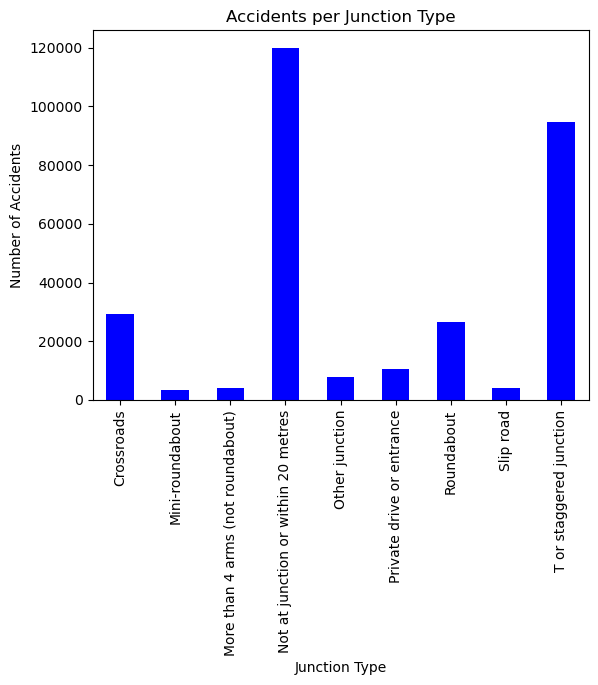

In [4]:
#Bar chart
junction_bar=junction_count.plot(kind='bar', color='blue')
junction_bar.set_xlabel("Junction Type")
junction_bar.set_ylabel("Number of Accidents")
junction_bar.set_title("Accidents per Junction Type")
plt.show()

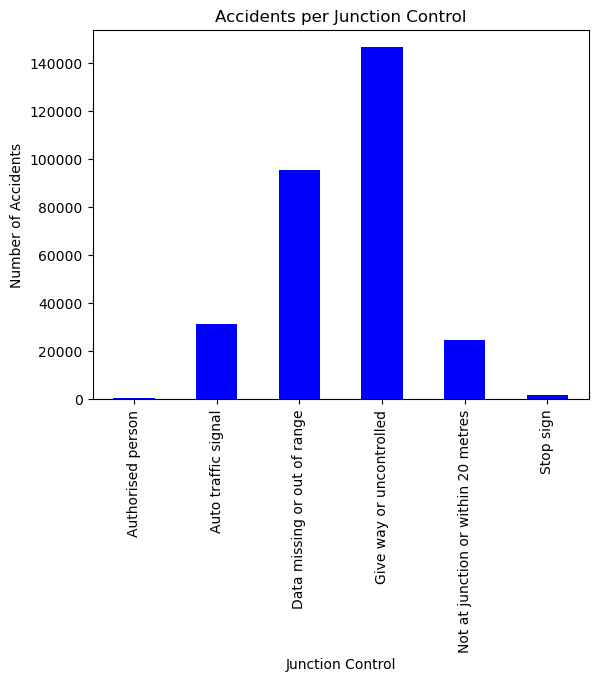

In [5]:
junction_bar=junction_c_count.plot(kind='bar', color='blue')
junction_bar.set_xlabel("Junction Control")
junction_bar.set_ylabel("Number of Accidents")
junction_bar.set_title("Accidents per Junction Control")
plt.show()

In [6]:
#Is the accident severity affected by the speed?

In [10]:
#Does geographic location with road type in mind have an effect on the number of accidents that occur?
import plotly.express as px

fig1 = px.histogram(accident_df, x='Urban_or_Rural_Area', 
                    title='Urban vs Rural Casualties', 
                    labels={'Urban_or_Rural_Area':'Area Type', 'count':'Number of Accidents'})
fig1.show()


In [12]:
#Number of Accidents vs Road Types
fig2 = px.histogram(accident_df, x='Road_Type', 
                    title='Most Dangerous Road Types', 
                    labels={'Road_Type':'Road Type', 'count':'Number of Accidents'},
                    color_discrete_sequence=px.colors.qualitative.G10)
fig2.show()

In [18]:
#Geographic locations vs Road Types
fig3 = px.histogram(accident_df, y='Road_Type', color='Urban_or_Rural_Area', 
                    title='Urban or Rural Area vs Road Type', 
                    labels={'Road_Type':'Road Type', 'count':'Number of Accidents'},
                    color_discrete_sequence=px.colors.qualitative.Plotly)
fig3.show()